# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [2]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

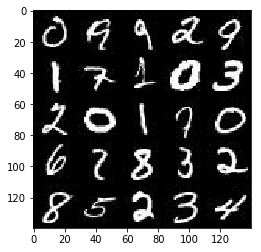

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

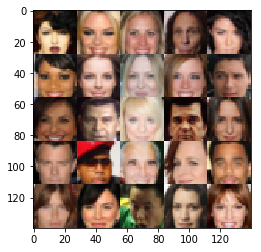

In [4]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [5]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.0.0
Default GPU Device: /gpu:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [6]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    print(image_width)
    print(image_height)
    print(image_channels)
    print(z_dim)


    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    
    # TODO: Implement Function
    input_real = tf.placeholder(dtype=tf.float32, shape=(None, image_width, image_height, image_channels),name='input_real')
    input_z = tf.placeholder(dtype=tf.float32, shape=(None, z_dim), name='input_z')
    learning_rate = tf.placeholder(dtype=tf.float16, name='learning_rate')
    return input_real, input_z, learning_rate


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

28
28
3
100
Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [7]:
def discriminator(images, reuse=False, alpha=0.2):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    with tf.variable_scope('discriminator', reuse=reuse):
        # TODO: Implement Function
        # Conv1 - 28x28x3
        conv1 = tf.layers.conv2d(images, 64, 5, strides=2, padding='same')
        #batch_norm1 = tf.layers.batch_normalization(conv1, training=True)
        leaky_relu1 = tf.maximum(alpha*conv1, conv1) 
        
        # Conv2 - 14x14x128
        conv2 = tf.layers.conv2d(leaky_relu1, 128, 5, strides=2, padding='same')
        batch_norm2 = tf.layers.batch_normalization(conv2, training=True)
        leaky_relu2 = tf.maximum(alpha*batch_norm2, batch_norm2) 

        # Conv3 - 7x7x256
        conv3 = tf.layers.conv2d(leaky_relu2, 256, 5, strides=1, padding='same')
        batch_norm3 = tf.layers.batch_normalization(conv3, training=True)
        leaky_relu3 = tf.maximum(alpha*batch_norm3, batch_norm3) 

#         # Conv3 - 3x3x512
#         conv4 = tf.layers.conv2d(inputs=leaky_relu3, filters=1024, kernel_size=5, strides=2, padding='same', activation=None)
#         batch_norm3 = tf.layers.batch_normalization(conv3, training=True)
#         leaky_relu3 = tf.maximum(alpha*batch_norm3, batch_norm3) 
     
        # 1x1x1024
        flat = tf.reshape(leaky_relu3, (-1, 7*7*256))
        logits = tf.layers.dense(flat, 1, activation=None)
        out = tf.sigmoid(logits)
        
        return out, logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [8]:
##### import problem_unittests


def generator(z, out_channel_dim, is_train=True, alpha=0.2):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """        
    with tf.variable_scope('generator', reuse= not is_train ):
        x = tf.layers.dense(z, 7*7*256, activation=None)
        # Reshape 1 dimentional array into 4x4x512 for each input
        x = tf.reshape(x, (-1, 7, 7, 256))
        x = tf.layers.batch_normalization(x, training=is_train)
        x = tf.maximum(alpha*x, x)
            
        # conv2d_transpose1 into 7x7x256
        conv1_t = tf.layers.conv2d_transpose(x, 
                                             128, 
                                             5, 
                                             strides=1,
                                             padding='same')
        # 14x14x512
        conv1_t_bn = tf.layers.batch_normalization(conv1_t, training=is_train)
        conv1_t_relu = tf.maximum(alpha*conv1_t_bn, conv1_t_bn)
        
        
        # conv2d_transpose2 into 14x14x128
        conv2_t = tf.layers.conv2d_transpose(conv1_t_relu, 
                                             128, 
                                             5, 
                                             strides=2, 
                                             padding='same')
        conv2_t_bn = tf.layers.batch_normalization(conv2_t, training=is_train)
        conv2_t_relu = tf.maximum(alpha*conv2_t_bn, conv2_t_bn)
            
#         # conv2d_transpose1 into 12x12x128
#         conv3_t = tf.layers.conv2d_transpose(inputs=conv2_t_relu, 
#                                              filters=256, 
#                                              kernel_size=5, 
#                                              strides=2, 
#                                              padding='same', 
#                                              activation=None)
#         conv3_t_bn = tf.layers.batch_normalization(conv3_t, training=is_train)
#         conv3_t_relu = tf.maximum(alpha*conv3_t_bn, conv3_t_bn)
        
        # conv2d_transpose into 28 x 28 x out_channel_dim
        # tanh
        logits = tf.layers.conv2d_transpose(conv2_t_relu, 
                                            out_channel_dim, 
                                            5, 
                                            strides=2, 
                                            padding='same')
        out = tf.tanh(logits)
        return out

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [9]:
def model_loss(input_real, input_z, out_channel_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function
    generator_out = generator(z=input_z, out_channel_dim=out_channel_dim, is_train=True, alpha=alpha)
    d_model_real, d_logits_real = discriminator(images=input_real, reuse=False, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(images=generator_out, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real))
    )
    
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake))
    )
    
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake))
    )
    
    d_loss = d_loss_real + d_loss_fake
    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [10]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]
    
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [11]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [25]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode, print_every=10):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # Build Model
    #def model_inputs(image_width, image_height, image_channels, z_dim):

    input_real, input_z, lr = model_inputs(data_shape[1],
                                         data_shape[2],
                                         data_shape[3],
                                         z_dim)
    
    d_loss, g_loss = model_loss(input_real, input_z, data_shape[3], 0.2)
    d_opt, g_opt = model_opt(d_loss, g_loss, lr, beta1)
    
    
    saver = tf.train.Saver()
    #72 images
    sample_z = np.random.uniform(-1, 1, size=(72, *data_shape[1:]))

    steps = 0
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
                for batch_images in get_batches(batch_size):
                    batch_images = batch_images * 2
                    # TODO: Train Model
                    steps += 1
                     # Sample random noise for G
                    batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
                     # Run optimizers
                    _ = sess.run(d_opt, feed_dict={input_real: batch_images, 
                                                   input_z: batch_z, 
                                                   lr:learning_rate})
                    _ = sess.run(g_opt, feed_dict={input_z: batch_z, 
                                                   input_real: batch_images,
                                                   lr:learning_rate})

                    if steps % print_every == 0:
                        # At the end of each epoch, get the losses and print them out
                        train_loss_d = d_loss.eval({input_z: batch_z, input_real: batch_images})
                        train_loss_g = g_loss.eval({input_z: batch_z})

                        print("Epoch {}/{}...".format(epoch_i+1, epochs),
                              "Discriminator Loss: {:.4f}...".format(train_loss_d),
                              "Generator Loss: {:.4f}".format(train_loss_g))
                        # Save losses to view after training
                        _ = show_generator_output(sess, 72, input_z, data_shape[3], data_image_mode)
        

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

(60000, 28, 28, 1)
28
28
1
100
Epoch 1/2... Discriminator Loss: 1.9477... Generator Loss: 0.1708


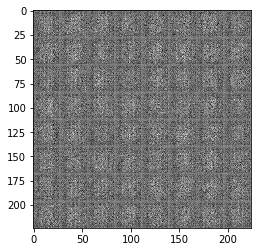

Epoch 1/2... Discriminator Loss: 2.3552... Generator Loss: 0.1174


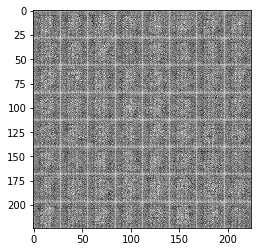

Epoch 1/2... Discriminator Loss: 1.7716... Generator Loss: 0.2286


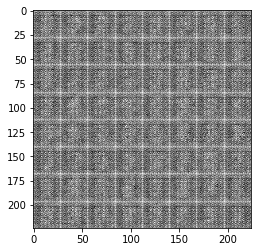

Epoch 1/2... Discriminator Loss: 0.9859... Generator Loss: 0.5716


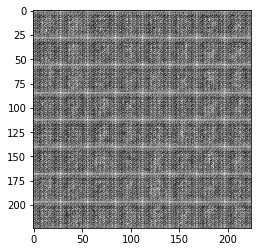

Epoch 1/2... Discriminator Loss: 1.7045... Generator Loss: 0.2536


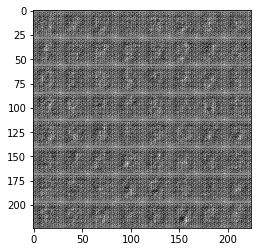

Epoch 1/2... Discriminator Loss: 1.3988... Generator Loss: 0.3601


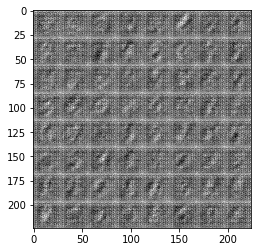

Epoch 1/2... Discriminator Loss: 1.5197... Generator Loss: 0.3144


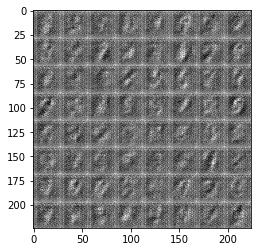

Epoch 1/2... Discriminator Loss: 1.4836... Generator Loss: 0.3280


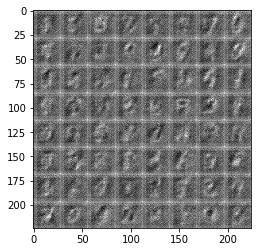

Epoch 1/2... Discriminator Loss: 1.5402... Generator Loss: 0.3139


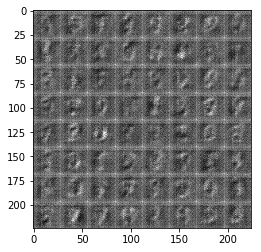

Epoch 1/2... Discriminator Loss: 1.5263... Generator Loss: 0.3249


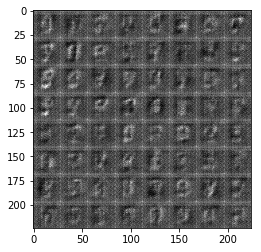

Epoch 1/2... Discriminator Loss: 1.2870... Generator Loss: 0.4266


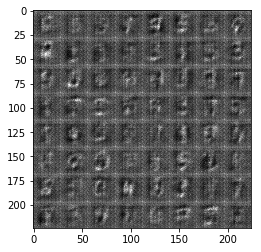

Epoch 1/2... Discriminator Loss: 1.3481... Generator Loss: 0.3893


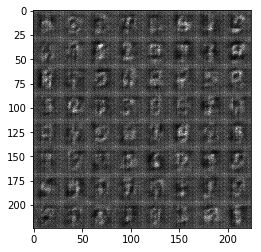

Epoch 1/2... Discriminator Loss: 1.2027... Generator Loss: 0.4665


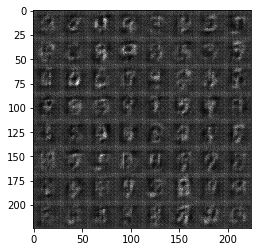

Epoch 1/2... Discriminator Loss: 1.3025... Generator Loss: 0.4049


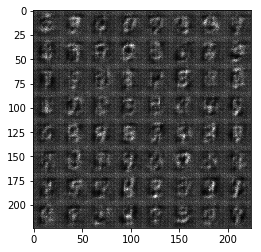

Epoch 1/2... Discriminator Loss: 1.2396... Generator Loss: 0.4336


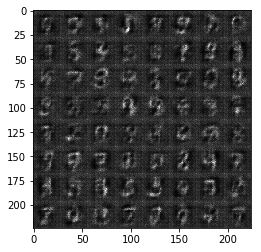

Epoch 1/2... Discriminator Loss: 1.1504... Generator Loss: 0.5075


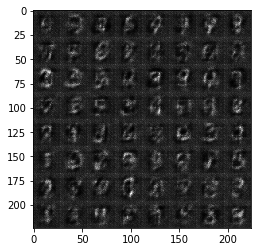

Epoch 1/2... Discriminator Loss: 1.1433... Generator Loss: 0.4986


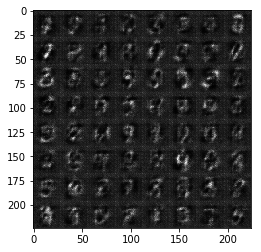

Epoch 1/2... Discriminator Loss: 1.1531... Generator Loss: 0.4888


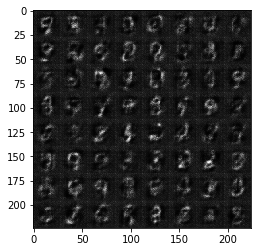

Epoch 1/2... Discriminator Loss: 1.1563... Generator Loss: 0.4787


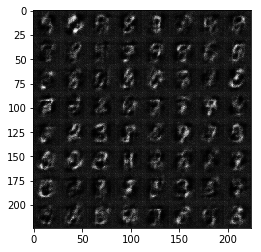

Epoch 1/2... Discriminator Loss: 1.0401... Generator Loss: 0.5699


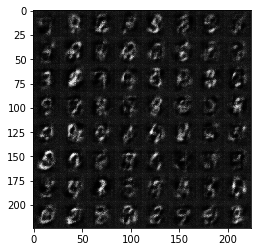

Epoch 1/2... Discriminator Loss: 1.1683... Generator Loss: 0.4745


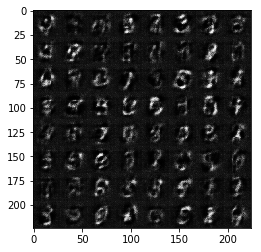

Epoch 1/2... Discriminator Loss: 1.0838... Generator Loss: 0.5328


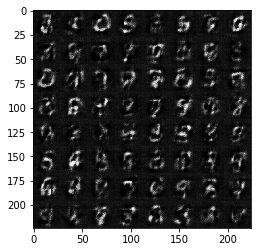

Epoch 1/2... Discriminator Loss: 1.0865... Generator Loss: 0.5341


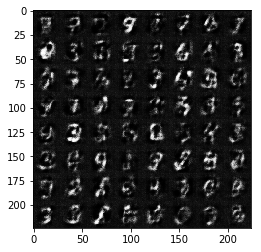

Epoch 1/2... Discriminator Loss: 0.9603... Generator Loss: 0.6333


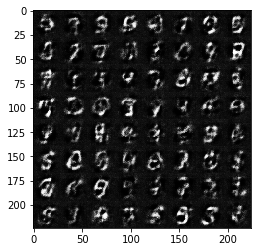

Epoch 1/2... Discriminator Loss: 1.0409... Generator Loss: 0.5633


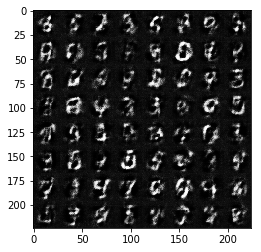

Epoch 1/2... Discriminator Loss: 1.0435... Generator Loss: 0.5509


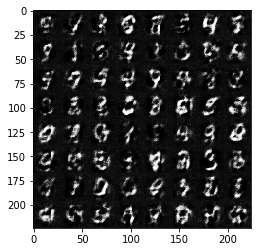

Epoch 1/2... Discriminator Loss: 0.9360... Generator Loss: 0.6585


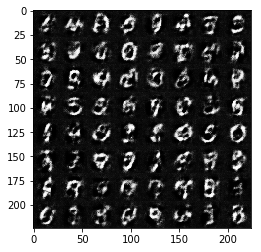

Epoch 1/2... Discriminator Loss: 0.9851... Generator Loss: 0.6003


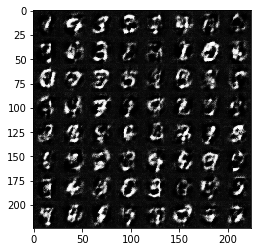

Epoch 1/2... Discriminator Loss: 1.0361... Generator Loss: 0.5593


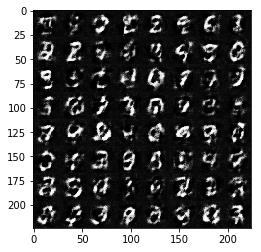

Epoch 1/2... Discriminator Loss: 0.9964... Generator Loss: 0.5949


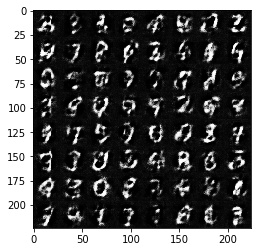

Epoch 2/2... Discriminator Loss: 0.9713... Generator Loss: 0.5998


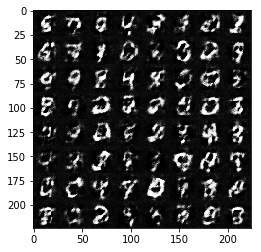

Epoch 2/2... Discriminator Loss: 0.9395... Generator Loss: 0.6523


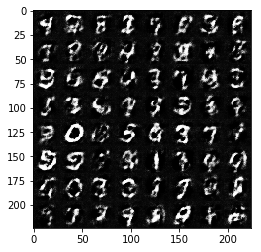

Epoch 2/2... Discriminator Loss: 0.9337... Generator Loss: 0.6456


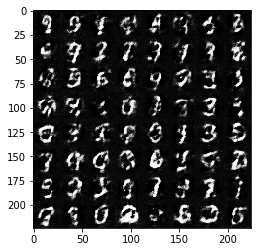

Epoch 2/2... Discriminator Loss: 0.9253... Generator Loss: 0.6595


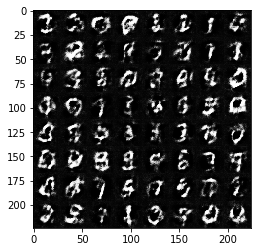

Epoch 2/2... Discriminator Loss: 1.1646... Generator Loss: 0.4755


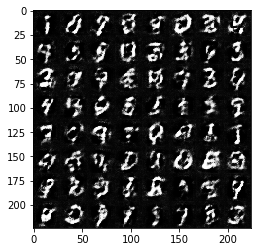

Epoch 2/2... Discriminator Loss: 0.9429... Generator Loss: 0.6495


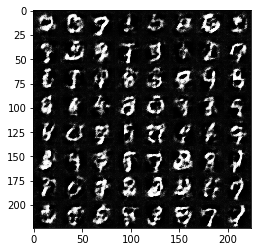

Epoch 2/2... Discriminator Loss: 1.0451... Generator Loss: 0.5430


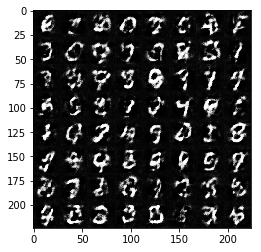

Epoch 2/2... Discriminator Loss: 0.8631... Generator Loss: 0.7449


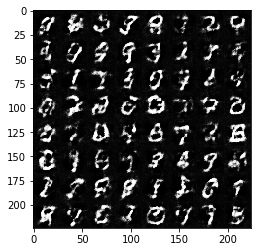

Epoch 2/2... Discriminator Loss: 1.1036... Generator Loss: 0.5190


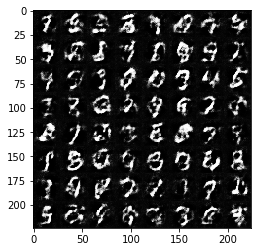

Epoch 2/2... Discriminator Loss: 1.0600... Generator Loss: 0.5541


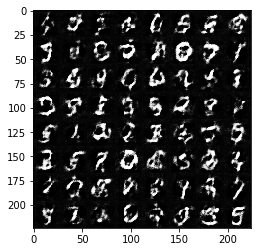

Epoch 2/2... Discriminator Loss: 1.0934... Generator Loss: 0.5290


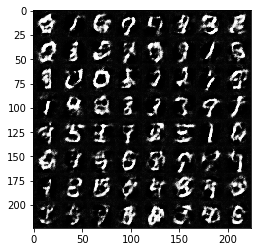

Epoch 2/2... Discriminator Loss: 1.1703... Generator Loss: 0.5047


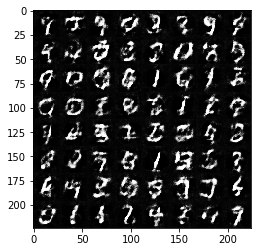

Epoch 2/2... Discriminator Loss: 1.0030... Generator Loss: 0.6212


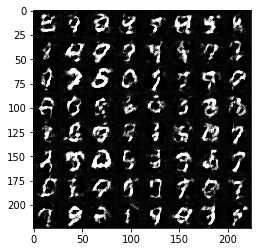

Epoch 2/2... Discriminator Loss: 1.2314... Generator Loss: 0.4505


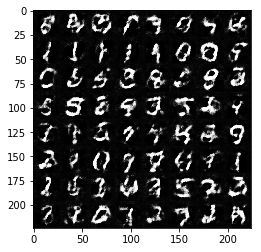

Epoch 2/2... Discriminator Loss: 1.1318... Generator Loss: 0.5039


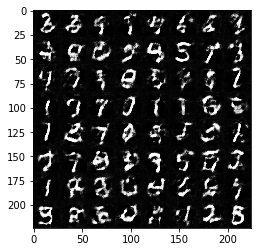

Epoch 2/2... Discriminator Loss: 1.1362... Generator Loss: 0.5129


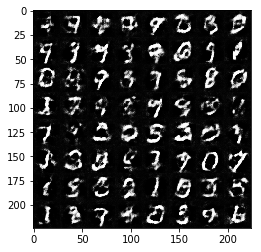

Epoch 2/2... Discriminator Loss: 1.0442... Generator Loss: 0.5634


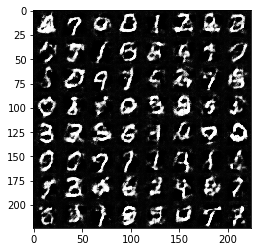

Epoch 2/2... Discriminator Loss: 1.0489... Generator Loss: 0.5672


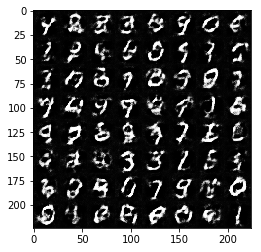

Epoch 2/2... Discriminator Loss: 1.1204... Generator Loss: 0.5023


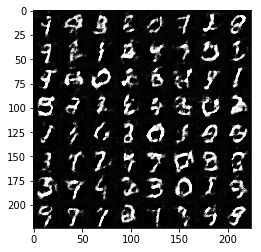

Epoch 2/2... Discriminator Loss: 1.1548... Generator Loss: 0.5033


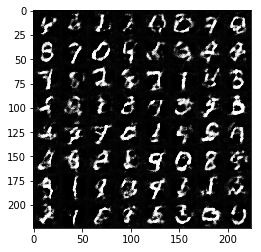

Epoch 2/2... Discriminator Loss: 1.0723... Generator Loss: 0.5589


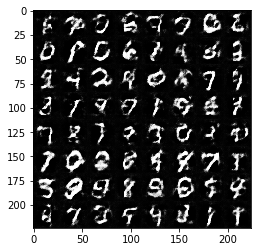

Epoch 2/2... Discriminator Loss: 1.0745... Generator Loss: 0.5582


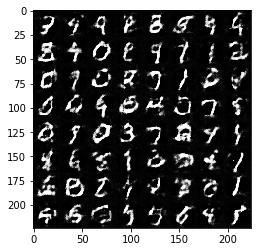

Epoch 2/2... Discriminator Loss: 1.1379... Generator Loss: 0.5132


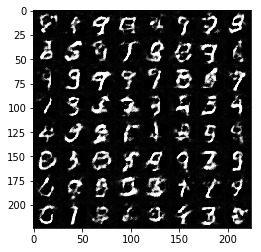

Epoch 2/2... Discriminator Loss: 0.9749... Generator Loss: 0.6297


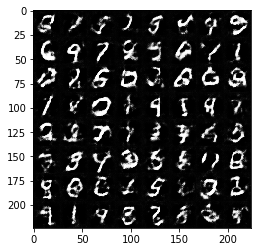

Epoch 2/2... Discriminator Loss: 1.1026... Generator Loss: 0.5305


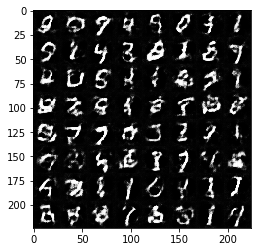

Epoch 2/2... Discriminator Loss: 1.1638... Generator Loss: 0.5059


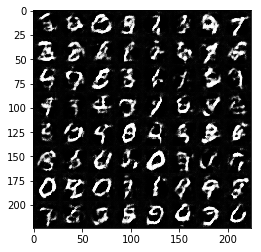

Epoch 2/2... Discriminator Loss: 0.9397... Generator Loss: 0.7501


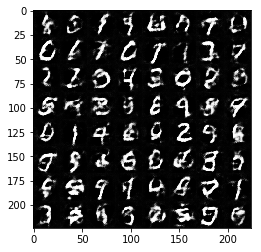

Epoch 2/2... Discriminator Loss: 1.1821... Generator Loss: 0.4775


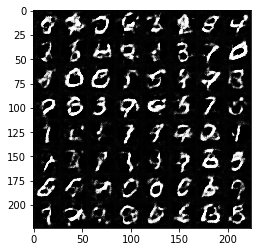

Epoch 2/2... Discriminator Loss: 1.1099... Generator Loss: 0.5176


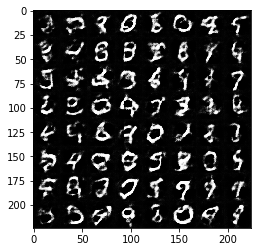

Epoch 2/2... Discriminator Loss: 1.1734... Generator Loss: 0.4816


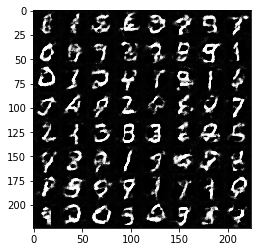

In [26]:
batch_size = 200
z_dim = 100
learning_rate = 0.0001
beta1 = 0.05


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
print( mnist_dataset.shape)
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

28
28
3
100
Epoch 1/1... Discriminator Loss: 1.0564... Generator Loss: 1.7281


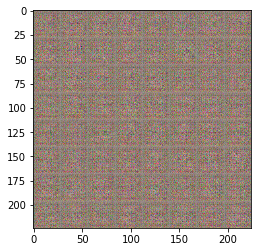

Epoch 1/1... Discriminator Loss: 1.5540... Generator Loss: 4.9447


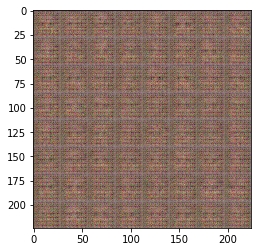

Epoch 1/1... Discriminator Loss: 1.5810... Generator Loss: 4.3580


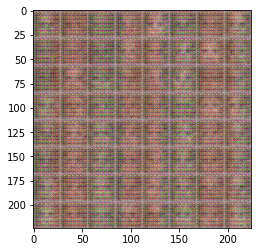

Epoch 1/1... Discriminator Loss: 1.9120... Generator Loss: 3.2320


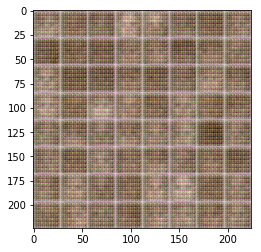

Epoch 1/1... Discriminator Loss: 1.5807... Generator Loss: 2.6472


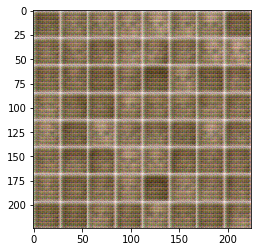

Epoch 1/1... Discriminator Loss: 1.9742... Generator Loss: 3.1057


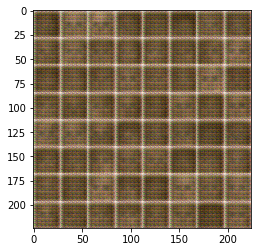

Epoch 1/1... Discriminator Loss: 1.5144... Generator Loss: 1.8995


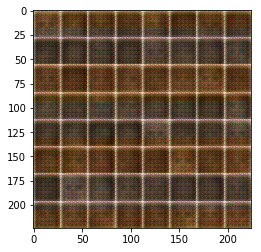

Epoch 1/1... Discriminator Loss: 2.0339... Generator Loss: 2.3236


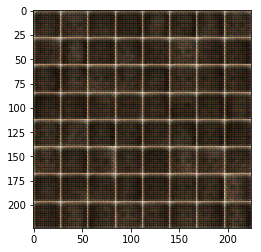

Epoch 1/1... Discriminator Loss: 1.6282... Generator Loss: 1.9523


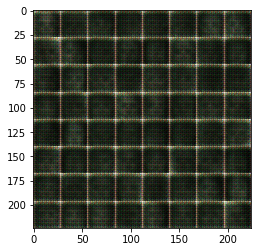

Epoch 1/1... Discriminator Loss: 1.6554... Generator Loss: 1.9728


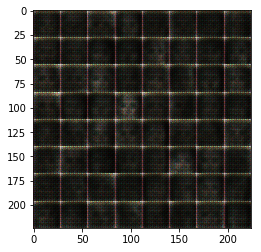

Epoch 1/1... Discriminator Loss: 1.5240... Generator Loss: 1.6370


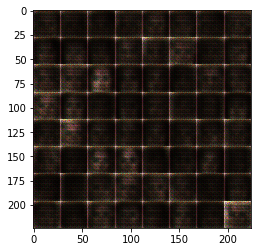

Epoch 1/1... Discriminator Loss: 1.2350... Generator Loss: 1.5998


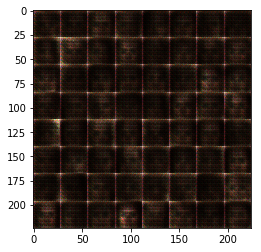

Epoch 1/1... Discriminator Loss: 1.4207... Generator Loss: 1.5804


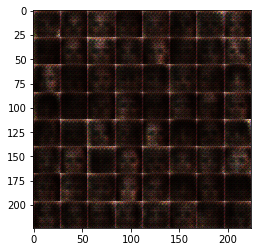

Epoch 1/1... Discriminator Loss: 1.6842... Generator Loss: 1.4197


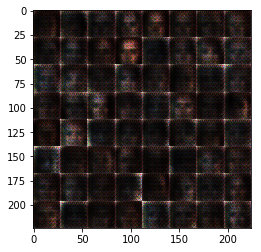

Epoch 1/1... Discriminator Loss: 1.3820... Generator Loss: 1.4630


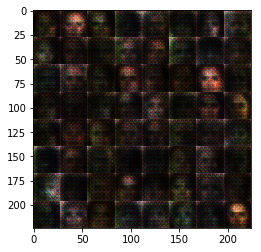

Epoch 1/1... Discriminator Loss: 1.4610... Generator Loss: 1.5191


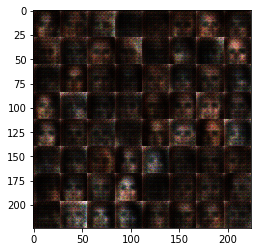

Epoch 1/1... Discriminator Loss: 1.5817... Generator Loss: 1.4680


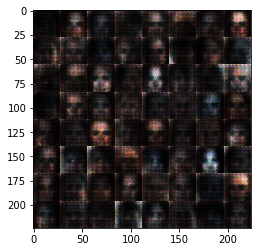

Epoch 1/1... Discriminator Loss: 1.2251... Generator Loss: 2.0169


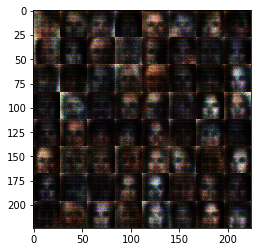

Epoch 1/1... Discriminator Loss: 1.5046... Generator Loss: 1.8251


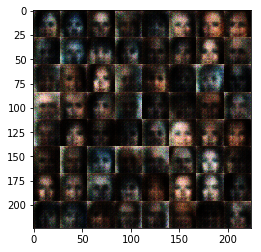

Epoch 1/1... Discriminator Loss: 1.5445... Generator Loss: 1.6418


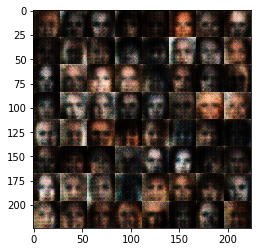

Epoch 1/1... Discriminator Loss: 1.2912... Generator Loss: 1.5893


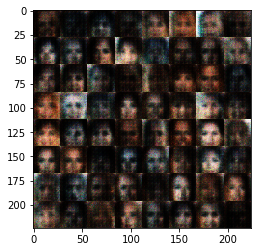

Epoch 1/1... Discriminator Loss: 1.2905... Generator Loss: 1.4609


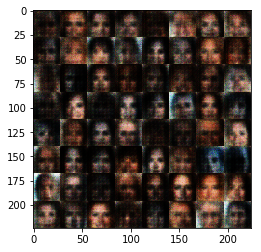

Epoch 1/1... Discriminator Loss: 1.3107... Generator Loss: 1.7623


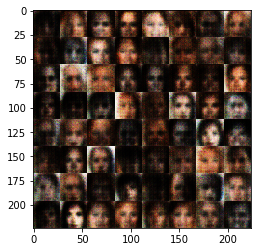

Epoch 1/1... Discriminator Loss: 1.0605... Generator Loss: 1.5390


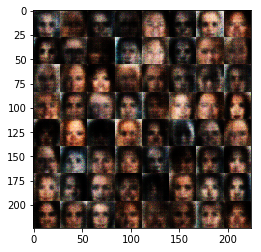

Epoch 1/1... Discriminator Loss: 1.0183... Generator Loss: 1.8502


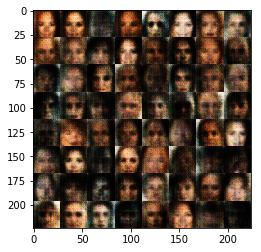

Epoch 1/1... Discriminator Loss: 0.8100... Generator Loss: 2.3283


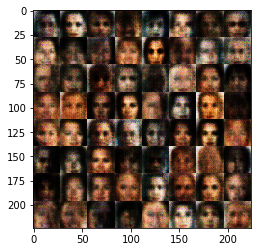

Epoch 1/1... Discriminator Loss: 0.8055... Generator Loss: 1.8534


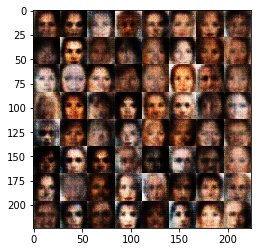

Epoch 1/1... Discriminator Loss: 1.3794... Generator Loss: 2.2973


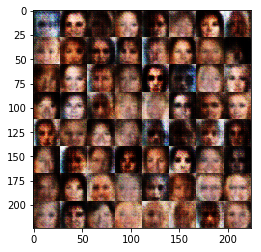

Epoch 1/1... Discriminator Loss: 1.2590... Generator Loss: 1.5179


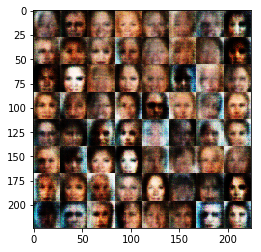

Epoch 1/1... Discriminator Loss: 1.3613... Generator Loss: 2.2109


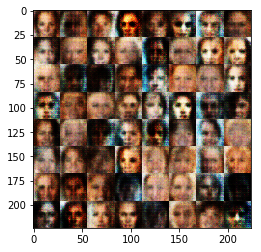

Epoch 1/1... Discriminator Loss: 1.1277... Generator Loss: 2.0260


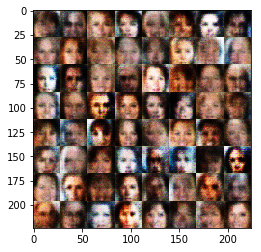

Epoch 1/1... Discriminator Loss: 1.1863... Generator Loss: 2.1370


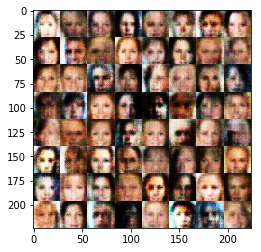

Epoch 1/1... Discriminator Loss: 1.1849... Generator Loss: 1.7043


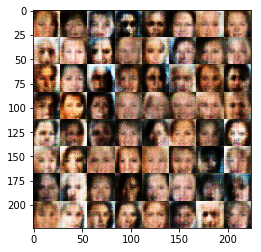

Epoch 1/1... Discriminator Loss: 1.5154... Generator Loss: 1.1684


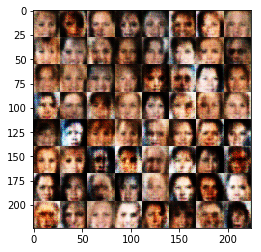

Epoch 1/1... Discriminator Loss: 1.5841... Generator Loss: 2.7721


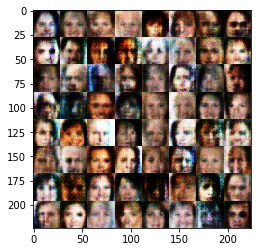

Epoch 1/1... Discriminator Loss: 1.2482... Generator Loss: 2.4974


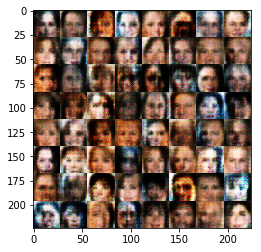

Epoch 1/1... Discriminator Loss: 0.9762... Generator Loss: 2.4325


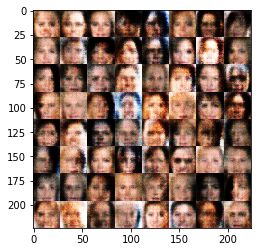

Epoch 1/1... Discriminator Loss: 1.2423... Generator Loss: 2.1968


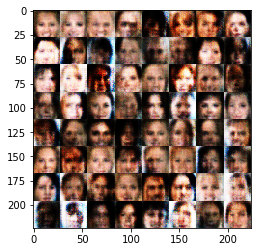

Epoch 1/1... Discriminator Loss: 1.0715... Generator Loss: 2.0464


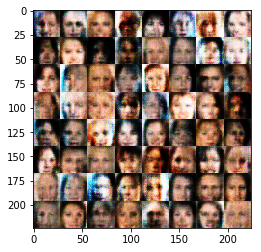

Epoch 1/1... Discriminator Loss: 0.8857... Generator Loss: 2.8773


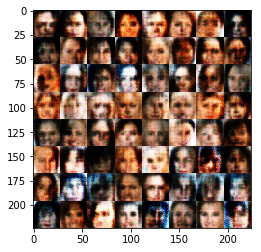

Epoch 1/1... Discriminator Loss: 0.7869... Generator Loss: 2.3801


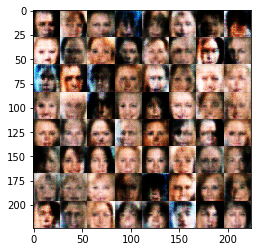

Epoch 1/1... Discriminator Loss: 1.1089... Generator Loss: 3.1233


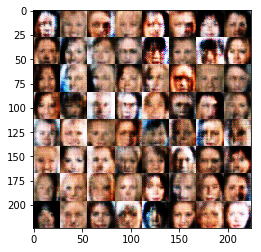

Epoch 1/1... Discriminator Loss: 0.5762... Generator Loss: 1.8945


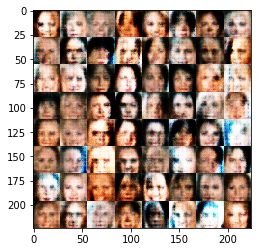

Epoch 1/1... Discriminator Loss: 0.9507... Generator Loss: 1.4714


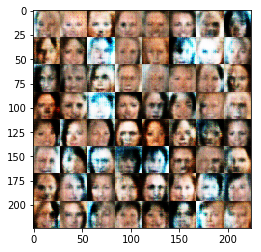

Epoch 1/1... Discriminator Loss: 0.9161... Generator Loss: 0.6288


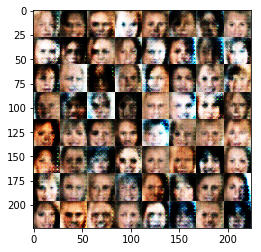

Epoch 1/1... Discriminator Loss: 0.5764... Generator Loss: 1.1692


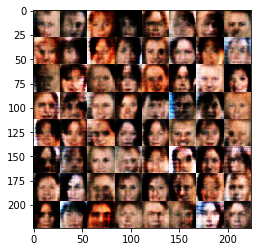

Epoch 1/1... Discriminator Loss: 1.3709... Generator Loss: 0.3574


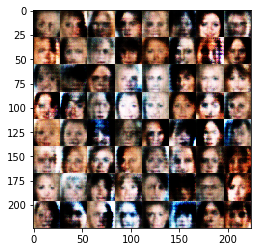

Epoch 1/1... Discriminator Loss: 1.1880... Generator Loss: 0.4875


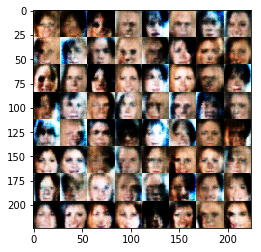

Epoch 1/1... Discriminator Loss: 0.2872... Generator Loss: 1.9086


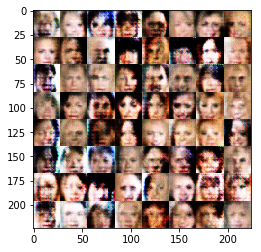

Epoch 1/1... Discriminator Loss: 0.6407... Generator Loss: 0.9984


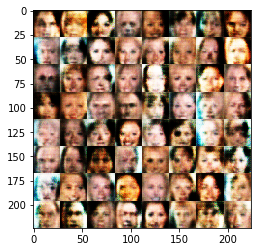

Epoch 1/1... Discriminator Loss: 1.6303... Generator Loss: 1.7336


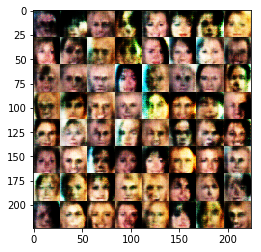

Epoch 1/1... Discriminator Loss: 1.1343... Generator Loss: 3.3691


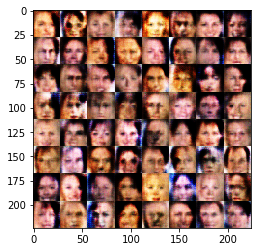

Epoch 1/1... Discriminator Loss: 0.6232... Generator Loss: 3.3350


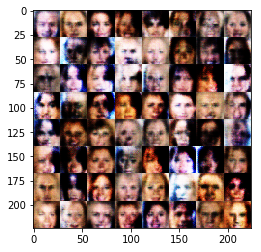

Epoch 1/1... Discriminator Loss: 1.1269... Generator Loss: 4.1911


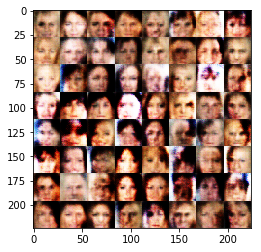

Epoch 1/1... Discriminator Loss: 1.1099... Generator Loss: 3.6090


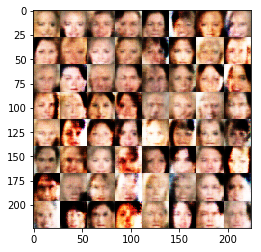

Epoch 1/1... Discriminator Loss: 0.3809... Generator Loss: 1.6589


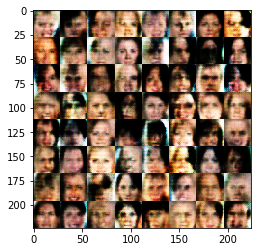

Epoch 1/1... Discriminator Loss: 0.9851... Generator Loss: 0.5848


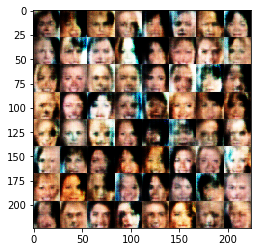

Epoch 1/1... Discriminator Loss: 1.2072... Generator Loss: 0.4566


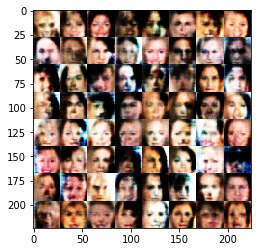

Epoch 1/1... Discriminator Loss: 0.4604... Generator Loss: 1.4138


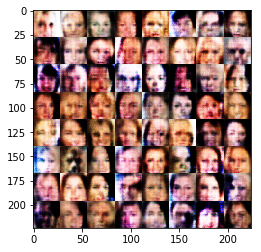

Epoch 1/1... Discriminator Loss: 1.1303... Generator Loss: 0.4924


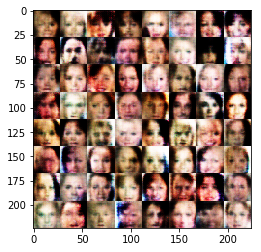

Epoch 1/1... Discriminator Loss: 0.3149... Generator Loss: 1.9574


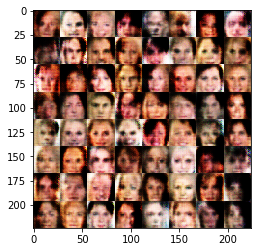

Epoch 1/1... Discriminator Loss: 1.1632... Generator Loss: 0.4856


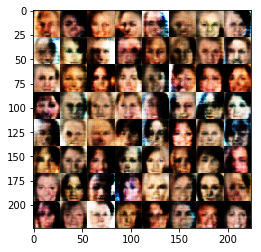

Epoch 1/1... Discriminator Loss: 1.1920... Generator Loss: 0.4802


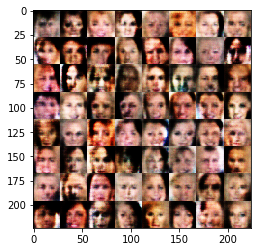

Epoch 1/1... Discriminator Loss: 0.5506... Generator Loss: 1.1004


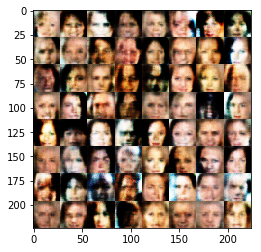

Epoch 1/1... Discriminator Loss: 0.5698... Generator Loss: 1.1925


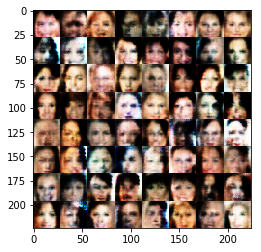

Epoch 1/1... Discriminator Loss: 1.0439... Generator Loss: 0.5335


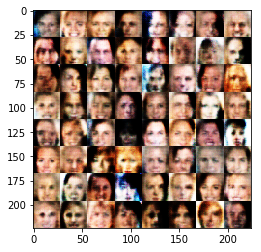

Epoch 1/1... Discriminator Loss: 1.3550... Generator Loss: 0.3812


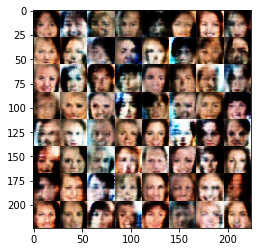

Epoch 1/1... Discriminator Loss: 0.5616... Generator Loss: 2.8317


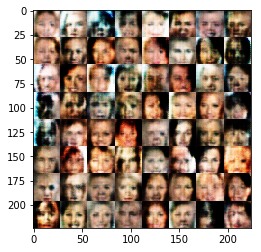

Epoch 1/1... Discriminator Loss: 0.5281... Generator Loss: 3.2305


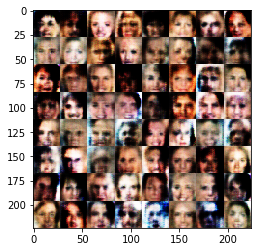

Epoch 1/1... Discriminator Loss: 0.6561... Generator Loss: 0.9636


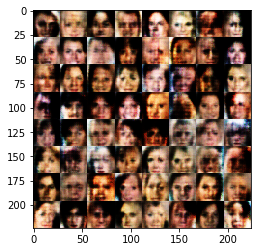

Epoch 1/1... Discriminator Loss: 0.9519... Generator Loss: 0.6929


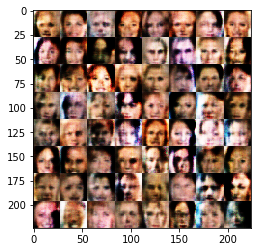

Epoch 1/1... Discriminator Loss: 0.2635... Generator Loss: 2.4060


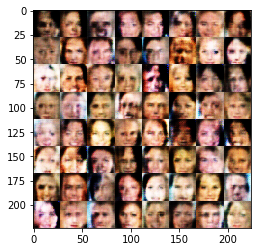

Epoch 1/1... Discriminator Loss: 0.5151... Generator Loss: 3.6187


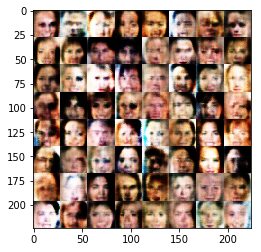

Epoch 1/1... Discriminator Loss: 2.1552... Generator Loss: 5.5665


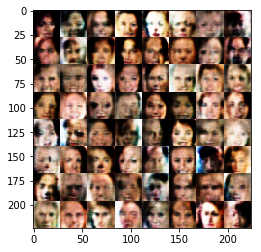

Epoch 1/1... Discriminator Loss: 0.9605... Generator Loss: 1.7182


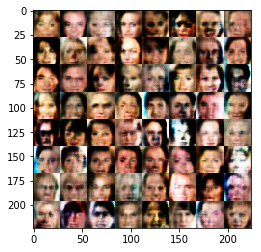

Epoch 1/1... Discriminator Loss: 0.6159... Generator Loss: 3.0026


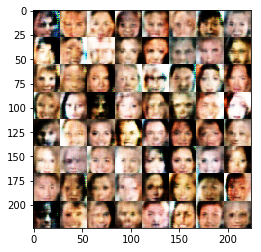

Epoch 1/1... Discriminator Loss: 0.7124... Generator Loss: 0.9136


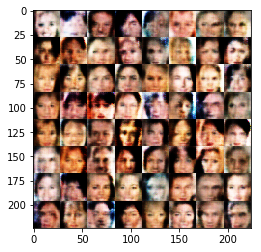

Epoch 1/1... Discriminator Loss: 1.3566... Generator Loss: 0.3807


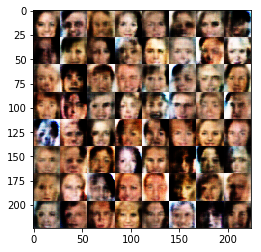

Epoch 1/1... Discriminator Loss: 1.0313... Generator Loss: 4.8825


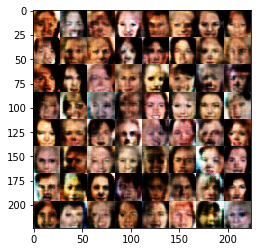

Epoch 1/1... Discriminator Loss: 1.0164... Generator Loss: 3.1972


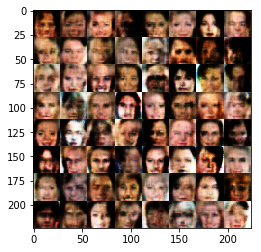

Epoch 1/1... Discriminator Loss: 0.3792... Generator Loss: 1.6551


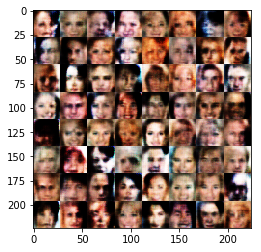

Epoch 1/1... Discriminator Loss: 1.2432... Generator Loss: 0.4186


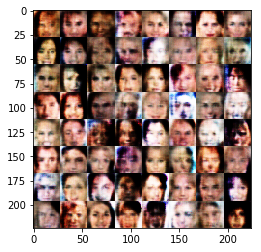

Epoch 1/1... Discriminator Loss: 0.8438... Generator Loss: 0.7746


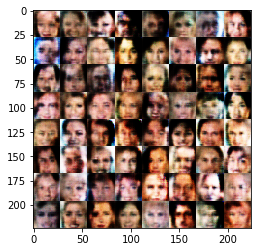

Epoch 1/1... Discriminator Loss: 1.1270... Generator Loss: 3.8487


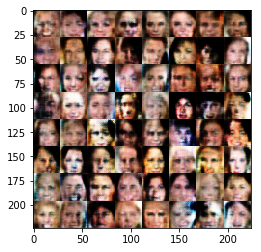

Epoch 1/1... Discriminator Loss: 0.6025... Generator Loss: 4.0340


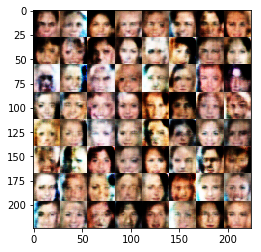

Epoch 1/1... Discriminator Loss: 1.6471... Generator Loss: 3.7116


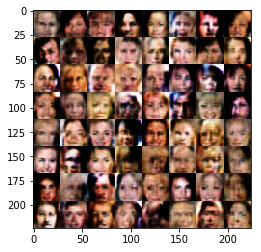

Epoch 1/1... Discriminator Loss: 0.6369... Generator Loss: 3.7186


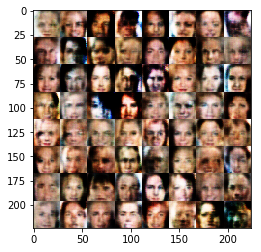

Epoch 1/1... Discriminator Loss: 0.3564... Generator Loss: 3.8896


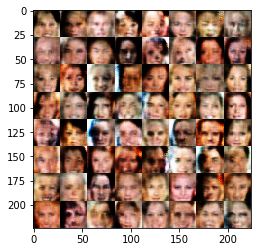

Epoch 1/1... Discriminator Loss: 0.4116... Generator Loss: 3.5821


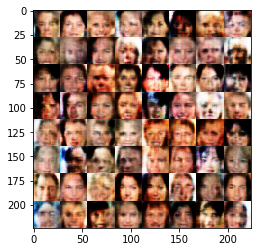

Epoch 1/1... Discriminator Loss: 0.4158... Generator Loss: 1.8895


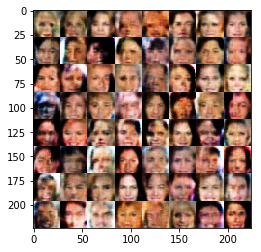

Epoch 1/1... Discriminator Loss: 0.3975... Generator Loss: 1.7553


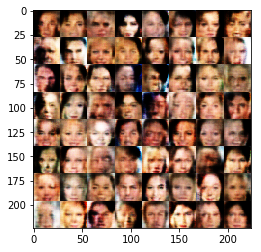

Epoch 1/1... Discriminator Loss: 0.3841... Generator Loss: 2.6321


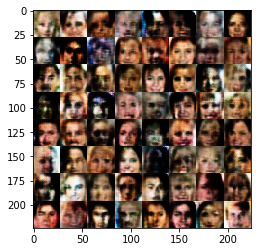

Epoch 1/1... Discriminator Loss: 1.0065... Generator Loss: 0.5567


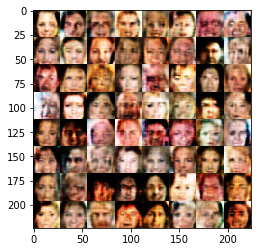

Epoch 1/1... Discriminator Loss: 0.4110... Generator Loss: 3.0461


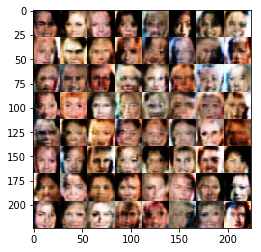

Epoch 1/1... Discriminator Loss: 1.2330... Generator Loss: 3.2159


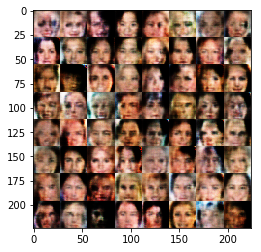

Epoch 1/1... Discriminator Loss: 0.5948... Generator Loss: 3.1631


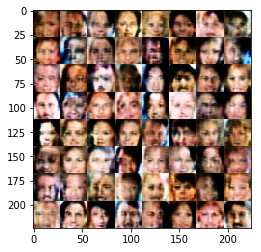

Epoch 1/1... Discriminator Loss: 0.5838... Generator Loss: 1.0487


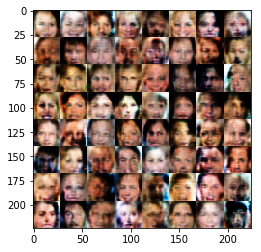

Epoch 1/1... Discriminator Loss: 0.3408... Generator Loss: 2.0905


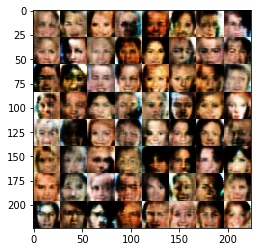

Epoch 1/1... Discriminator Loss: 2.0403... Generator Loss: 1.9910


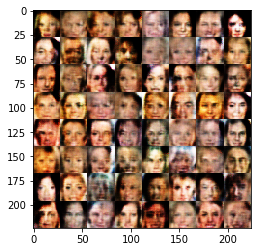

Epoch 1/1... Discriminator Loss: 0.3533... Generator Loss: 3.3405


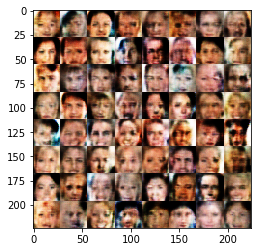

Epoch 1/1... Discriminator Loss: 0.4309... Generator Loss: 2.9552


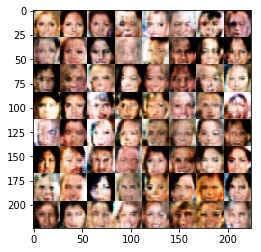

Epoch 1/1... Discriminator Loss: 0.6196... Generator Loss: 3.9575


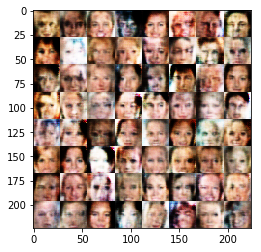

Epoch 1/1... Discriminator Loss: 0.6631... Generator Loss: 2.6265


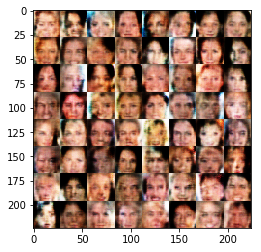

Epoch 1/1... Discriminator Loss: 0.8349... Generator Loss: 2.9307


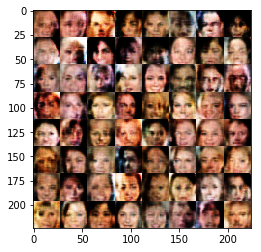

Epoch 1/1... Discriminator Loss: 1.2089... Generator Loss: 3.6154


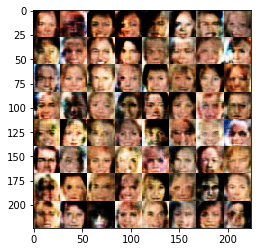

Epoch 1/1... Discriminator Loss: 0.8458... Generator Loss: 2.5986


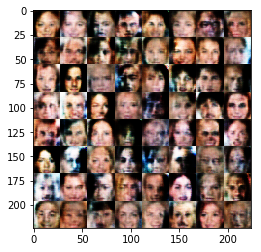

Epoch 1/1... Discriminator Loss: 0.9885... Generator Loss: 4.2683


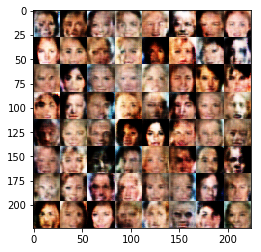

Epoch 1/1... Discriminator Loss: 0.5073... Generator Loss: 2.6085


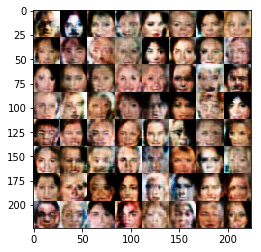

Epoch 1/1... Discriminator Loss: 0.5060... Generator Loss: 2.5941


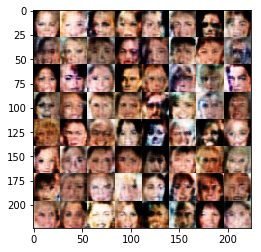

Epoch 1/1... Discriminator Loss: 1.3357... Generator Loss: 0.3891


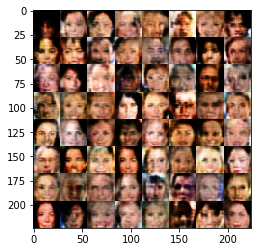

Epoch 1/1... Discriminator Loss: 2.2399... Generator Loss: 0.1699


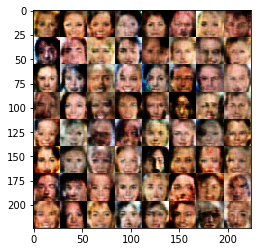

Epoch 1/1... Discriminator Loss: 0.5081... Generator Loss: 1.3790


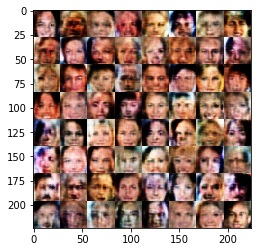

Epoch 1/1... Discriminator Loss: 0.6982... Generator Loss: 0.9511


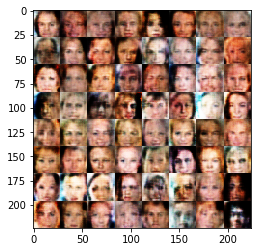

Epoch 1/1... Discriminator Loss: 1.1226... Generator Loss: 0.5017


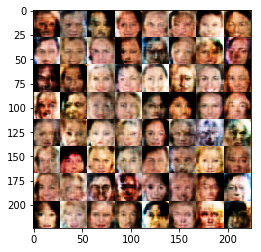

Epoch 1/1... Discriminator Loss: 0.7314... Generator Loss: 0.8622


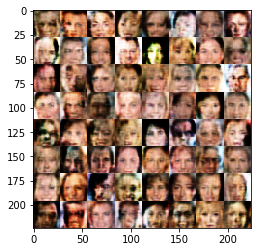

Epoch 1/1... Discriminator Loss: 0.3165... Generator Loss: 1.8862


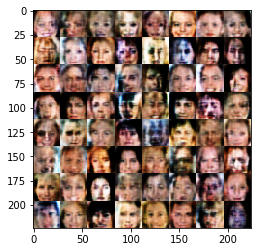

Epoch 1/1... Discriminator Loss: 0.5337... Generator Loss: 1.1972


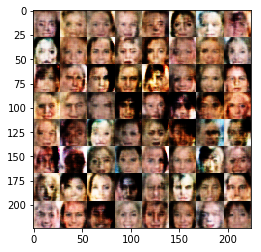

Epoch 1/1... Discriminator Loss: 0.4177... Generator Loss: 1.5541


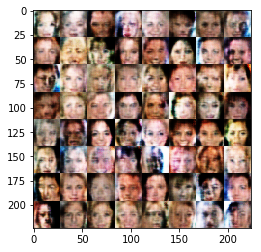

Epoch 1/1... Discriminator Loss: 0.3457... Generator Loss: 3.2088


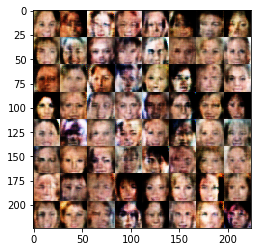

Epoch 1/1... Discriminator Loss: 0.7581... Generator Loss: 3.0404


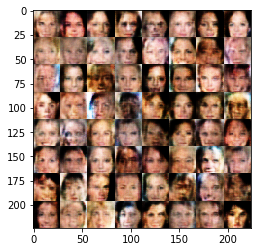

Epoch 1/1... Discriminator Loss: 0.4660... Generator Loss: 1.3611


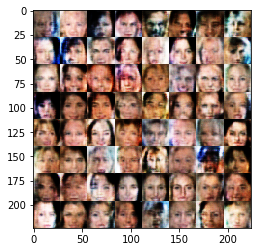

Epoch 1/1... Discriminator Loss: 0.7201... Generator Loss: 3.4259


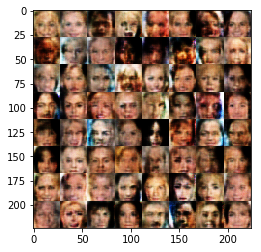

Epoch 1/1... Discriminator Loss: 0.7505... Generator Loss: 0.8573


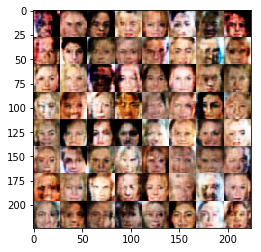

Epoch 1/1... Discriminator Loss: 0.2356... Generator Loss: 2.3780


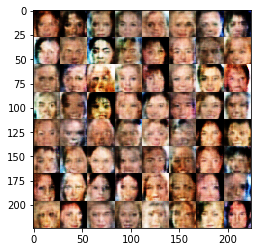

Epoch 1/1... Discriminator Loss: 0.5149... Generator Loss: 1.2488


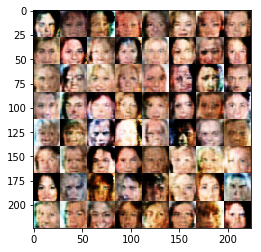

Epoch 1/1... Discriminator Loss: 0.6885... Generator Loss: 4.6609


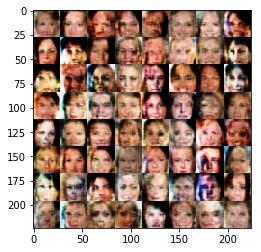

Epoch 1/1... Discriminator Loss: 3.0161... Generator Loss: 3.1827


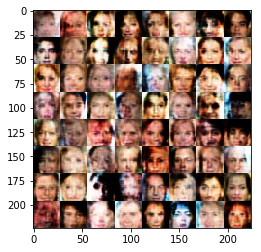

Epoch 1/1... Discriminator Loss: 0.7653... Generator Loss: 3.8744


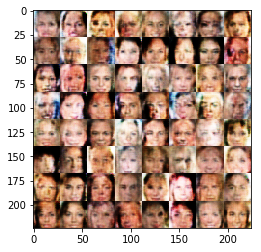

Epoch 1/1... Discriminator Loss: 0.4746... Generator Loss: 2.5543


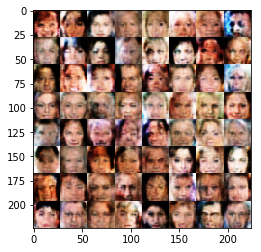

Epoch 1/1... Discriminator Loss: 0.2864... Generator Loss: 2.4237


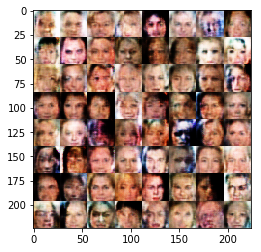

Epoch 1/1... Discriminator Loss: 0.9908... Generator Loss: 3.7056


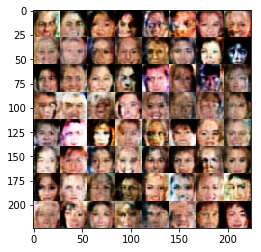

Epoch 1/1... Discriminator Loss: 0.4304... Generator Loss: 1.4460


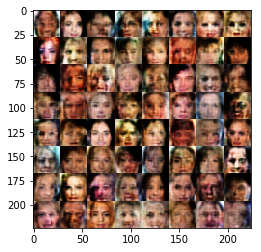

Epoch 1/1... Discriminator Loss: 0.4485... Generator Loss: 1.3095


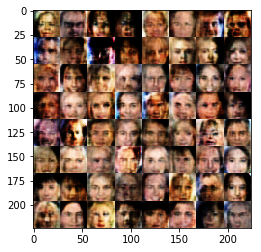

Epoch 1/1... Discriminator Loss: 1.6462... Generator Loss: 0.3105


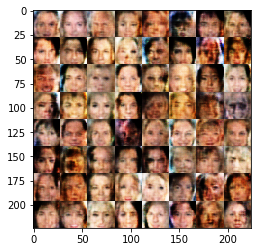

Epoch 1/1... Discriminator Loss: 0.5299... Generator Loss: 1.2104


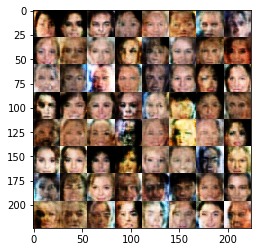

Epoch 1/1... Discriminator Loss: 0.3088... Generator Loss: 2.0328


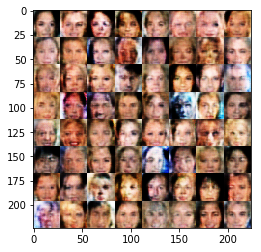

Epoch 1/1... Discriminator Loss: 1.2644... Generator Loss: 0.4625


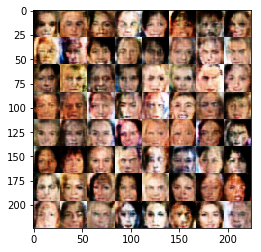

Epoch 1/1... Discriminator Loss: 0.3591... Generator Loss: 3.3867


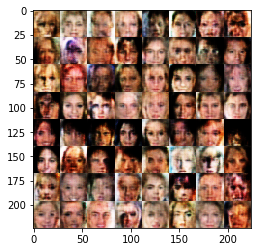

Epoch 1/1... Discriminator Loss: 0.4511... Generator Loss: 3.2385


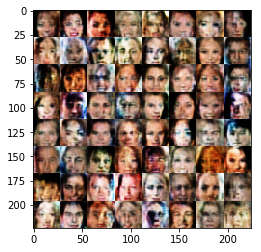

Epoch 1/1... Discriminator Loss: 0.5794... Generator Loss: 1.0659


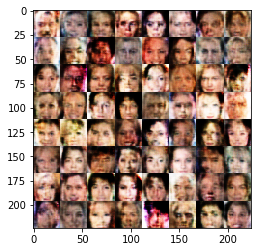

Epoch 1/1... Discriminator Loss: 0.1656... Generator Loss: 3.0981


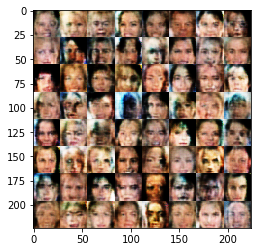

Epoch 1/1... Discriminator Loss: 0.3514... Generator Loss: 4.2213


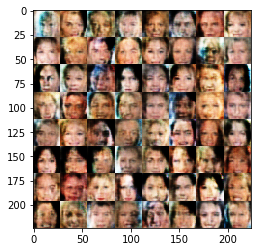

Epoch 1/1... Discriminator Loss: 0.1552... Generator Loss: 3.9165


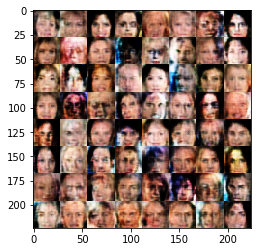

Epoch 1/1... Discriminator Loss: 0.3564... Generator Loss: 4.5778


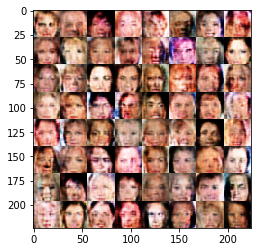

Epoch 1/1... Discriminator Loss: 1.5539... Generator Loss: 3.4695


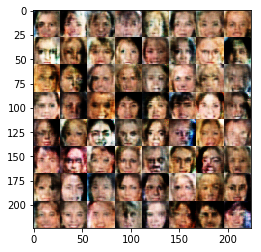

Epoch 1/1... Discriminator Loss: 1.3741... Generator Loss: 3.4067


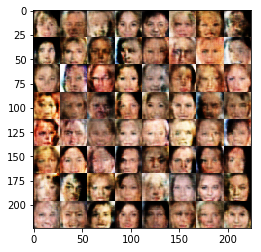

Epoch 1/1... Discriminator Loss: 0.2520... Generator Loss: 2.4175


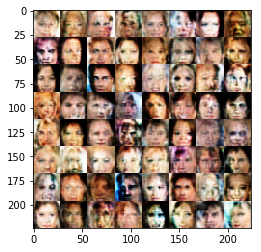

Epoch 1/1... Discriminator Loss: 0.7595... Generator Loss: 2.9616


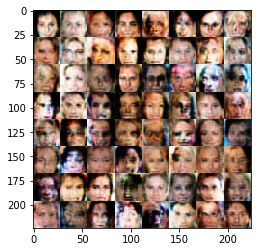

Epoch 1/1... Discriminator Loss: 0.2840... Generator Loss: 2.9409


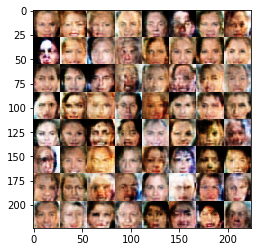

Epoch 1/1... Discriminator Loss: 1.1263... Generator Loss: 0.4809


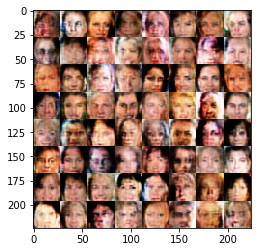

Epoch 1/1... Discriminator Loss: 0.3866... Generator Loss: 1.6079


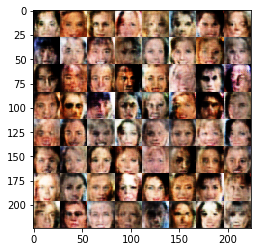

Epoch 1/1... Discriminator Loss: 0.5161... Generator Loss: 1.1666


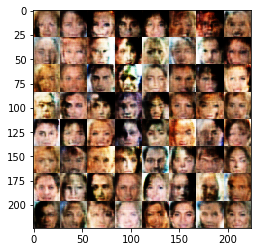

Epoch 1/1... Discriminator Loss: 0.2285... Generator Loss: 2.8415


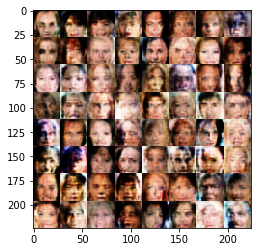

Epoch 1/1... Discriminator Loss: 1.0215... Generator Loss: 0.5627


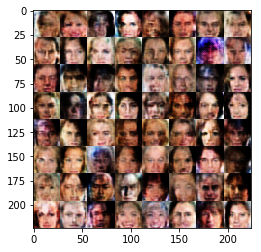

Epoch 1/1... Discriminator Loss: 0.5962... Generator Loss: 1.0251


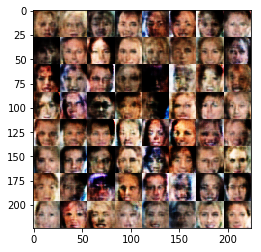

Epoch 1/1... Discriminator Loss: 0.3415... Generator Loss: 1.6085


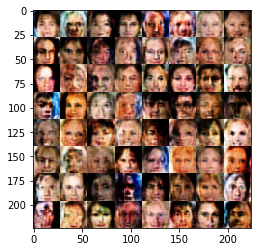

Epoch 1/1... Discriminator Loss: 0.7976... Generator Loss: 0.7322


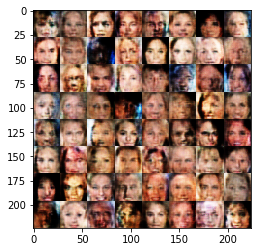

Epoch 1/1... Discriminator Loss: 0.6544... Generator Loss: 1.0324


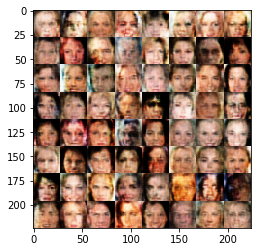

In [27]:
batch_size = 128
z_dim = 100
learning_rate = 0.0002
beta1 = 0.05


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.